In [4]:
import os
os.environ["KMP_DUPLICATE_LIB_OK"]="TRUE"
TORCH_CUDA_ARCH_LIST="8.6"
import cv2
import time
import random
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from glob import glob
import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
import torch.backends.cudnn as cudnn
import torchvision.transforms.functional as TF
import torchvision.transforms as transformtransforms
from tqdm import tqdm
from torchsummary import summary
from torchvision import transforms
from torchvision.transforms import ToPILImage
from torch.utils.data import Dataset, DataLoader
time_start_all = time.time()

EPOCH = 25
BATCH = 100
NUM_WORKERS = 0
SEED = 69
NOISE = 100
image_size = 64
LR = 0.0001

device_default = torch.cuda.current_device()
torch.cuda.device(device_default)
print('torch.cuda.get_device_name: ',torch.cuda.get_device_name(device_default))
device = torch.device("cuda")

#loading the dataset
transform=transforms.Compose([transforms.Resize(image_size),
                              transforms.CenterCrop(image_size),
                              transforms.ToTensor(),
                              transforms.Normalize((0.5, 0.5, 0.5),
                                                   (0.5, 0.5, 0.5)),
                              ])


dataset = torchvision.datasets.CIFAR10(root="./data/", 
                                       download=True,
                                       transform=transform)

dataloader = torch.utils.data.DataLoader(dataset, 
                                         batch_size=BATCH,
                                         shuffle=True, 
                                         num_workers=NUM_WORKERS)


print(dataset.classes)
print(dataset.data.shape)

class Generator(nn.Module):
    def __init__(self, noise = NOISE):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(noise, 512, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

    def initialize_weights(self, w_mean=0, w_std=0.02, b_mean=1, b_std=0.02):
        for m in self.modules():
            classname = m.__class__.__name__
            if classname.find('Conv') != -1:
                nn.init.normal_(m.weight.data, w_mean, w_std)
            elif classname.find('BatchNorm') != -1:
                nn.init.normal_(m.weight.data, b_mean, b_std)
                nn.init.constant_(m.bias.data, 0)

device = torch.device("cuda")
G = Generator().to(device)
summary(G, input_size=(100,1,1))


class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
            # nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

    def initialize_weights(self, w_mean=0, w_std=0.02, b_mean=1, b_std=0.02):
        for m in self.modules():
            classname = m.__class__.__name__
            if classname.find('Conv') != -1:
                nn.init.normal_(m.weight.data, w_mean, w_std)
            elif classname.find('BatchNorm') != -1:
                nn.init.normal_(m.weight.data, b_mean, b_std)
                nn.init.constant_(m.bias.data, 0)

device = torch.device("cuda")
D = Discriminator().to(device)
summary(D, input_size=(3,64,64))



def norm(data):
    data = ((data-np.min(data))/(np.max(data)-np.min(data))*255).astype(np.uint8)
    return data

def Image_wall(images):
    image = images[random.randint(0, 9)].detach().permute(1,2,0).cpu().numpy()
    frames_1 = np.array([])
    for i in range(0,5):
        frame_i = images[i].detach().permute(1,2,0).cpu().numpy()
        if i == 0: frames_1 = frame_i
        else: frames_1 = np.hstack((frames_1,frame_i))
        
    frames_2 = np.array([])            
    for i in range(5,10):
        frame_i = images[i].detach().permute(1,2,0).cpu().numpy()
        if i == 5: frames_2 = frame_i
        else: frames_2 = np.hstack((frames_2,frame_i))
        
    frames = np.vstack((frames_1,frames_2))
    # frames = cv2.cvtColor(frames, cv2.COLOR_BGR2RGB)
    frames = norm(frames)
    image = norm(image)
    return frames, image


'''
loss & optimizer
'''
torch.cuda.is_available()
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

# Using RMSprop

optimizer_G = optim.RMSprop(G.parameters(), lr=LR)
optimizer_D = optim.RMSprop(D.parameters(), lr=LR)


# criterion = nn.BCELoss()

input_noise = torch.randn(BATCH, NOISE, 1, 1)
input_noise = input_noise.to(device)

real_label = 1.0
fake_label = 0.0







torch.cuda.get_device_name:  Tesla V100-PCIE-32GB
Files already downloaded and verified
['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']
(50000, 32, 32, 3)
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]         819,200
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,152
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,288
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9          [-1, 128, 16, 16]               0
  ConvTranspose2d-10           [-1, 64, 32, 32]         131,072
      BatchNorm2d-11           [-

start training...
Epochs: 25 | Batch Size: 100 | Learning Rate: 0.0001


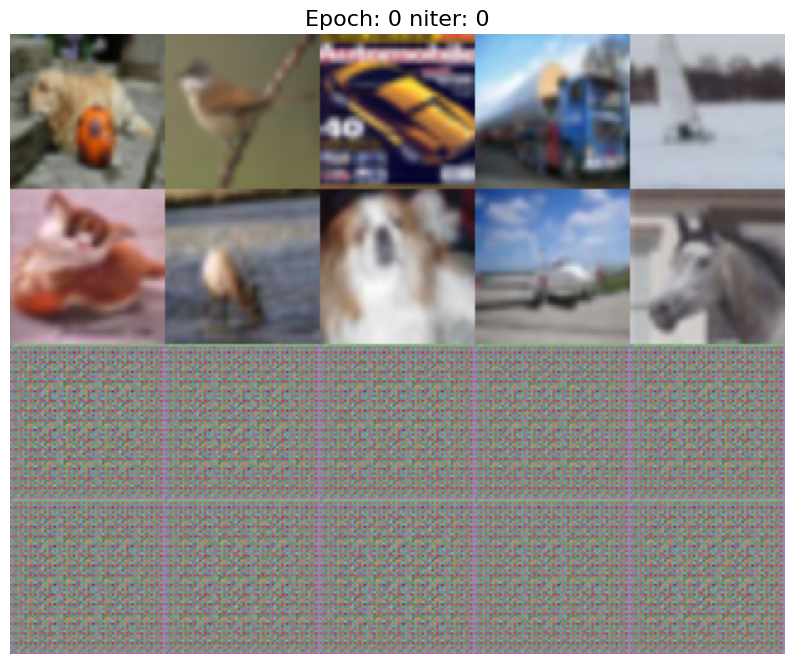

[1/25][0/500] Loss_D: -0.0459 Loss_G: 0.0364


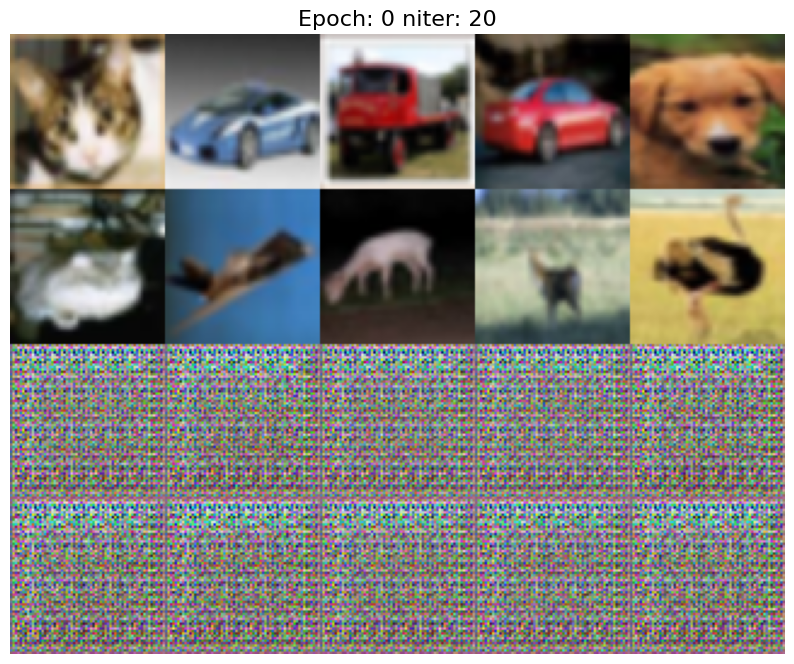

[1/25][20/500] Loss_D: -0.0008 Loss_G: -0.0030


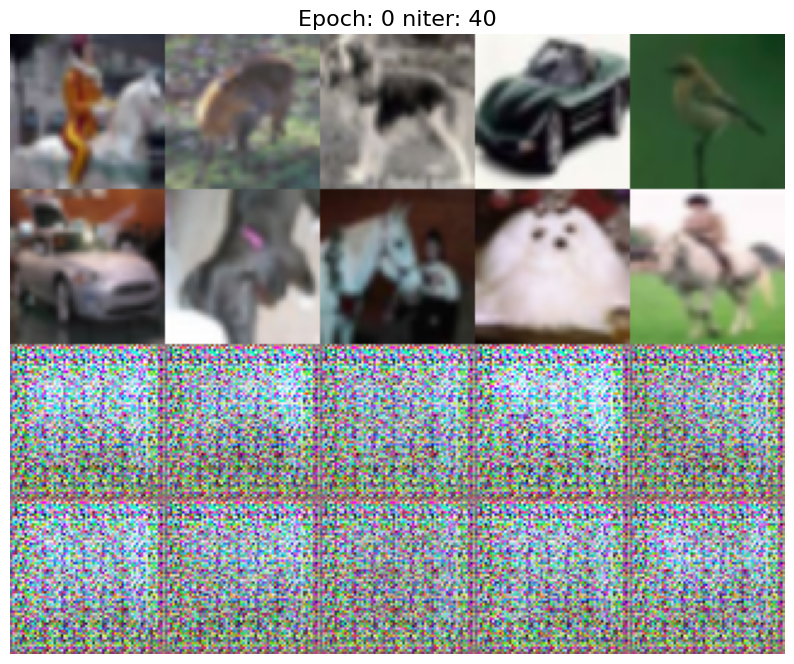

[1/25][40/500] Loss_D: -0.0033 Loss_G: -0.0036


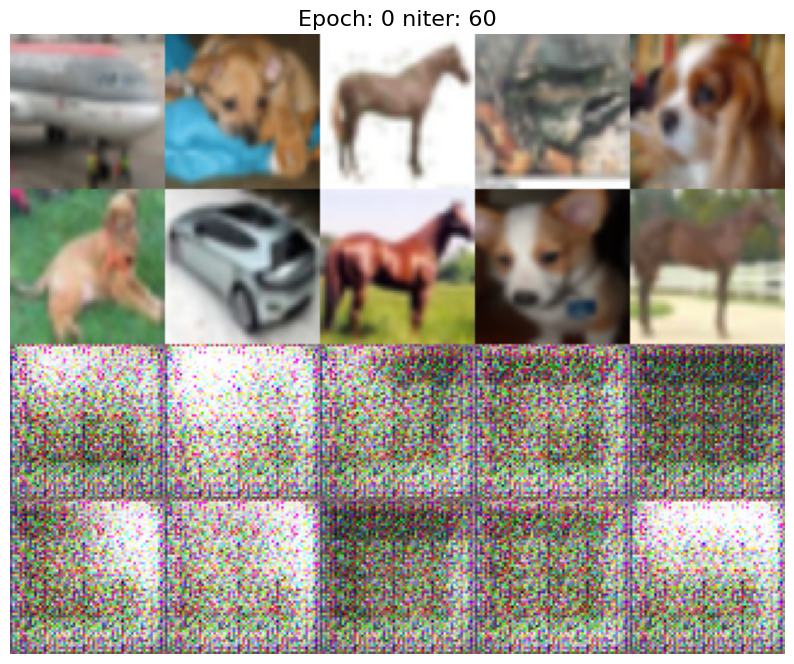

[1/25][60/500] Loss_D: -0.0007 Loss_G: -0.0053


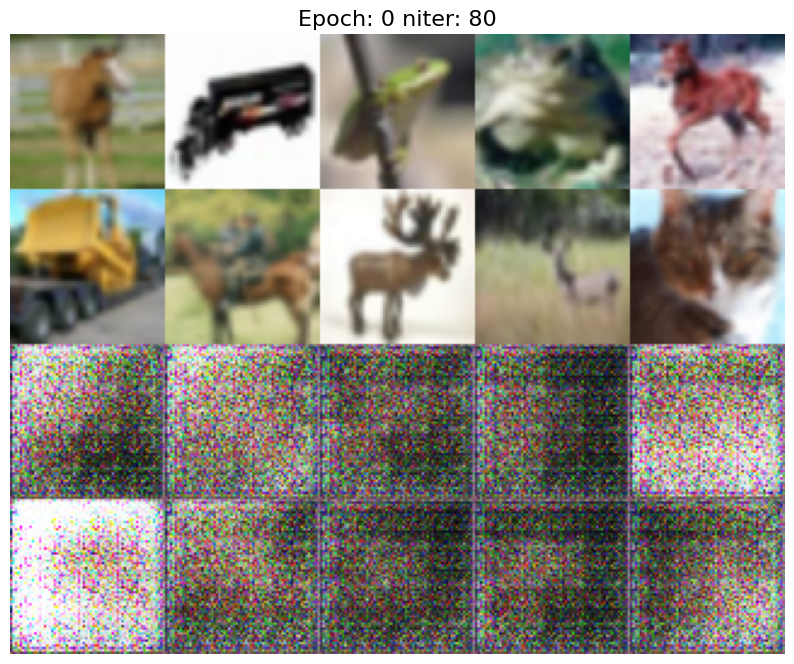

[1/25][80/500] Loss_D: -0.0002 Loss_G: -0.0029


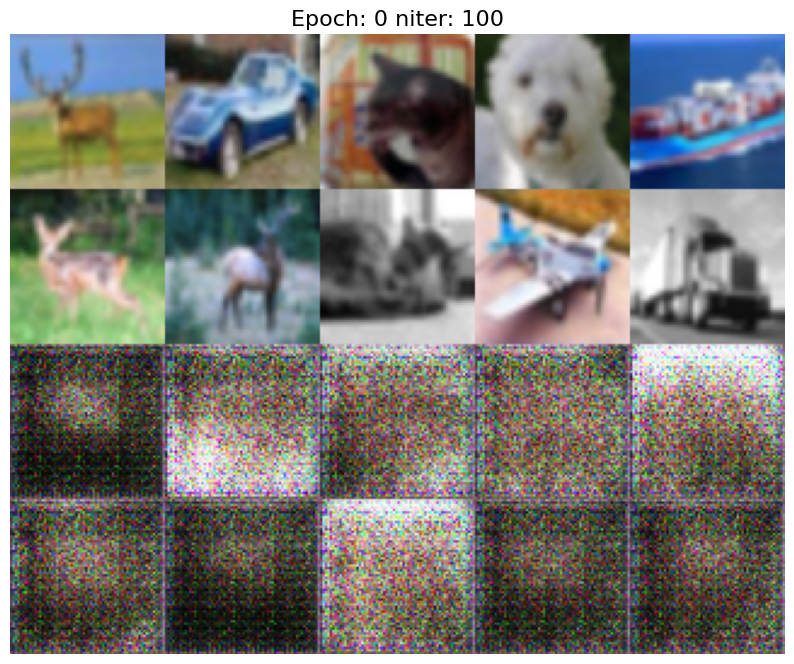

[1/25][100/500] Loss_D: -0.0000 Loss_G: -0.0020


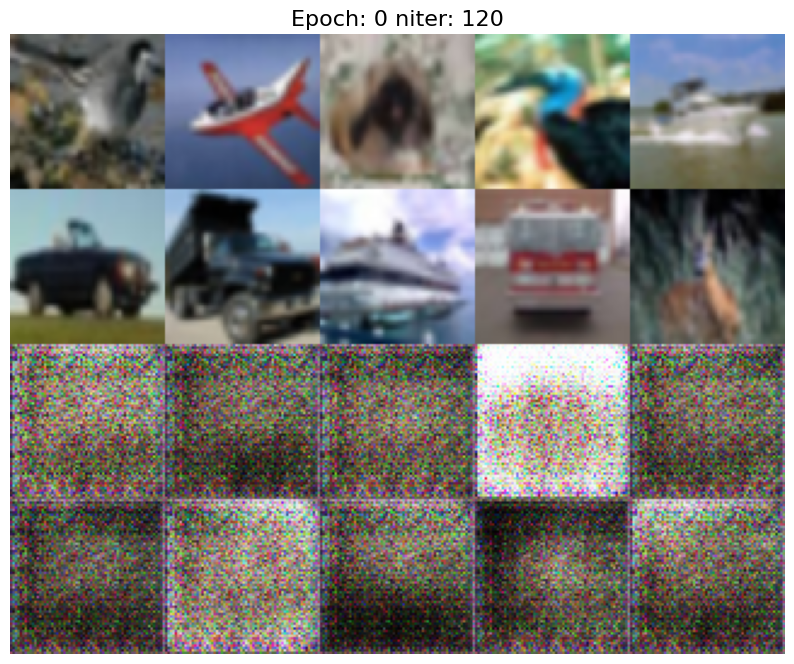

[1/25][120/500] Loss_D: -0.0000 Loss_G: -0.0015


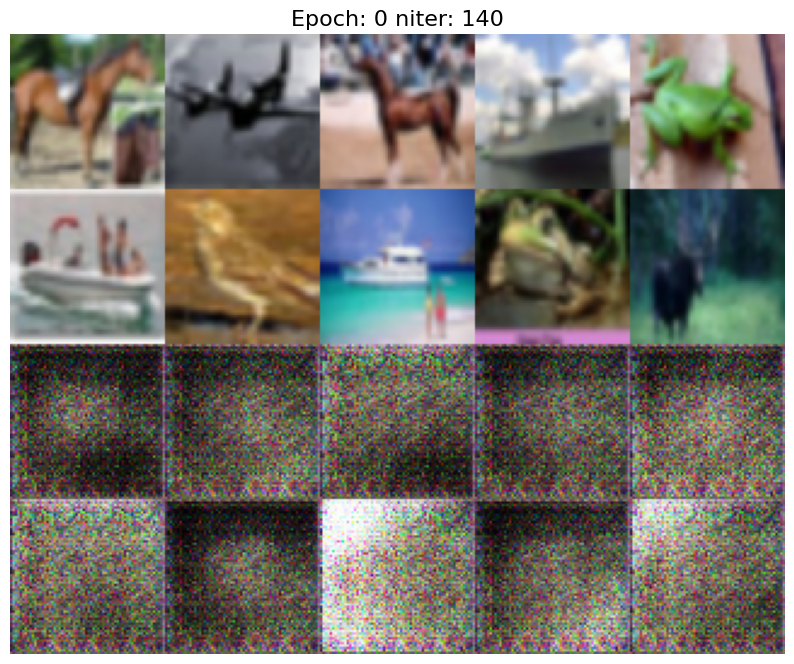

[1/25][140/500] Loss_D: 0.0001 Loss_G: -0.0012


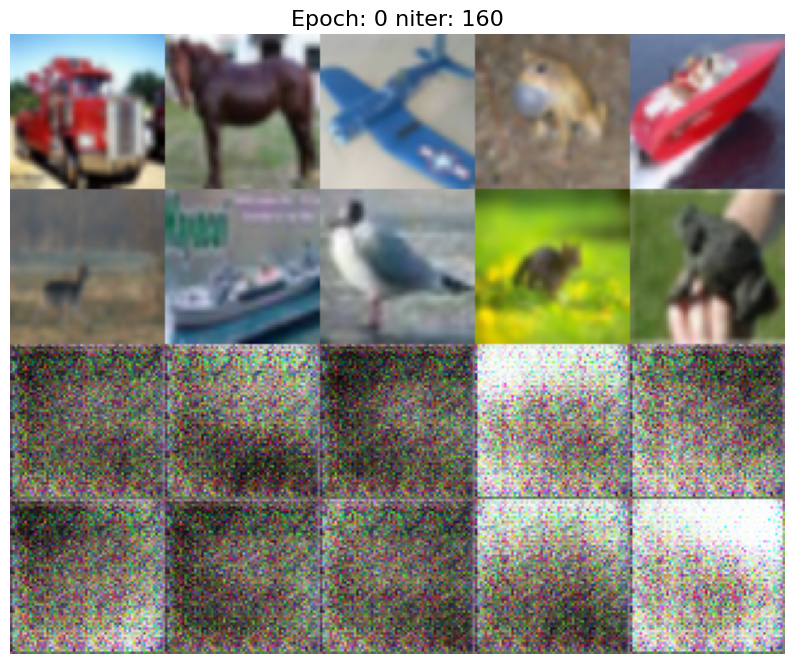

[1/25][160/500] Loss_D: 0.0001 Loss_G: -0.0011


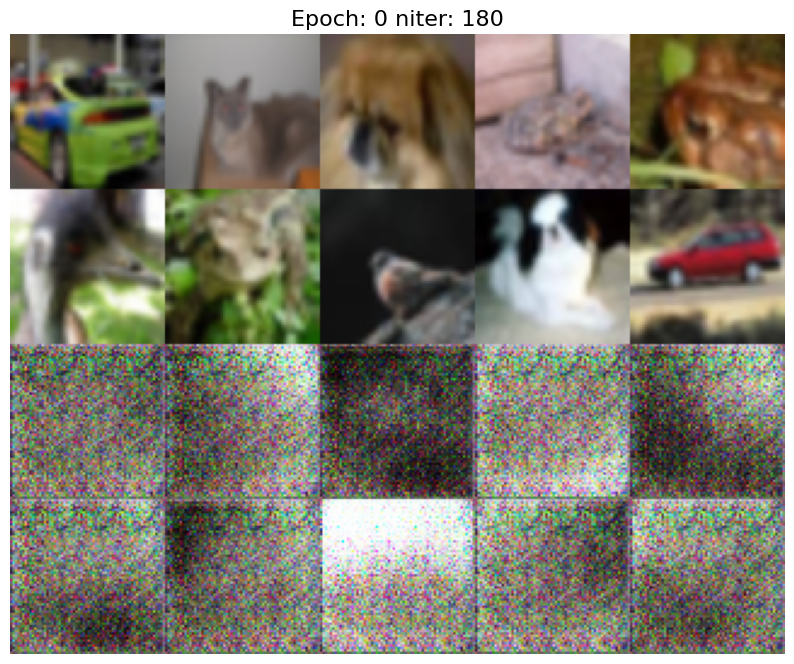

[1/25][180/500] Loss_D: 0.0000 Loss_G: -0.0012


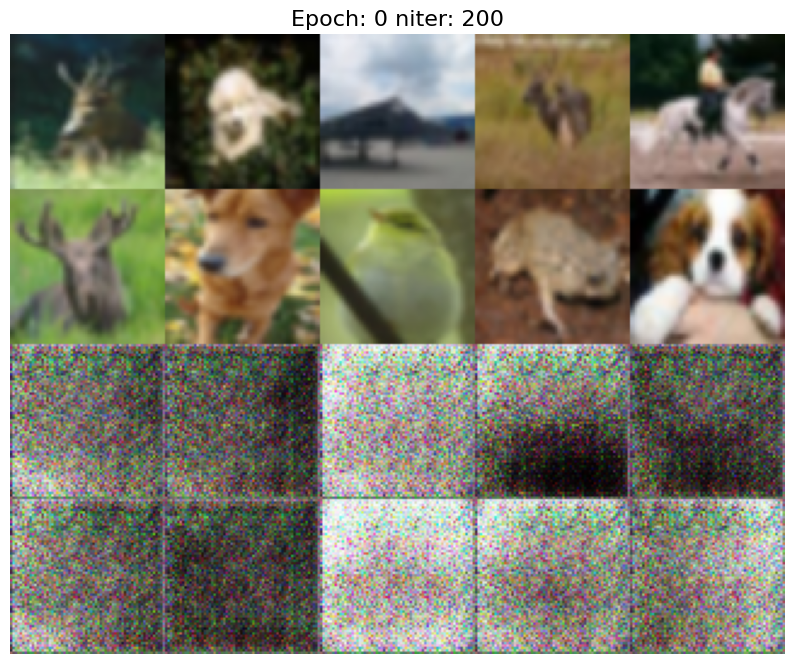

[1/25][200/500] Loss_D: -0.0000 Loss_G: -0.0014


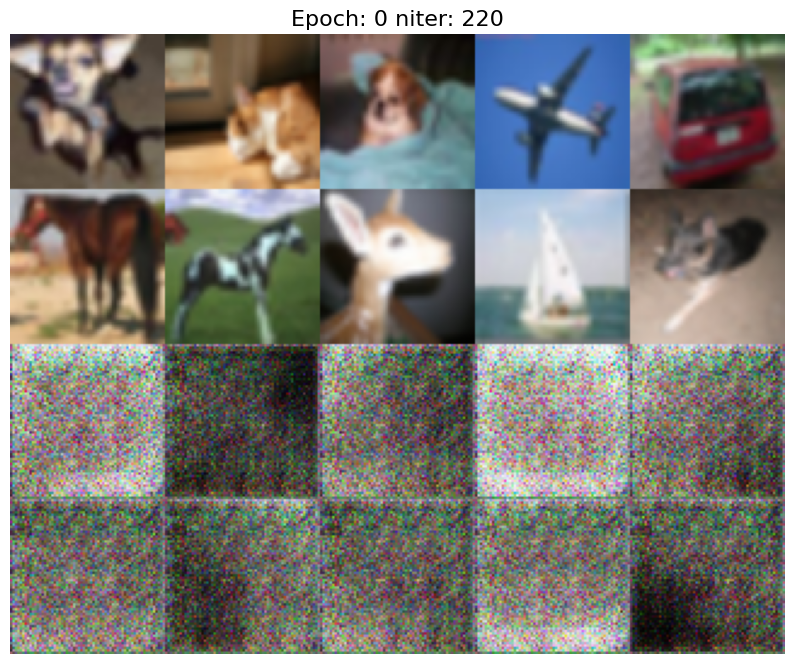

[1/25][220/500] Loss_D: -0.0001 Loss_G: -0.0012


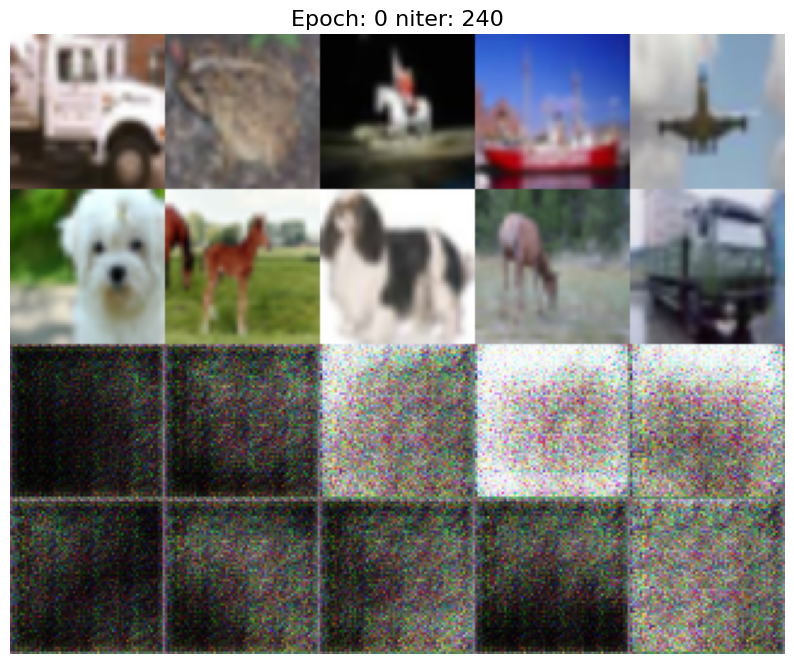

[1/25][240/500] Loss_D: -0.0001 Loss_G: -0.0012


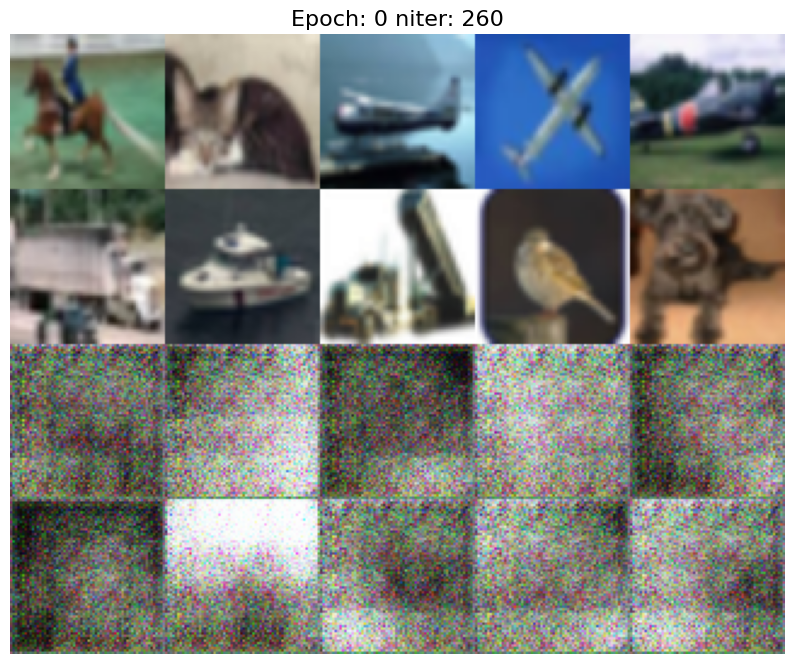

[1/25][260/500] Loss_D: -0.0002 Loss_G: -0.0014


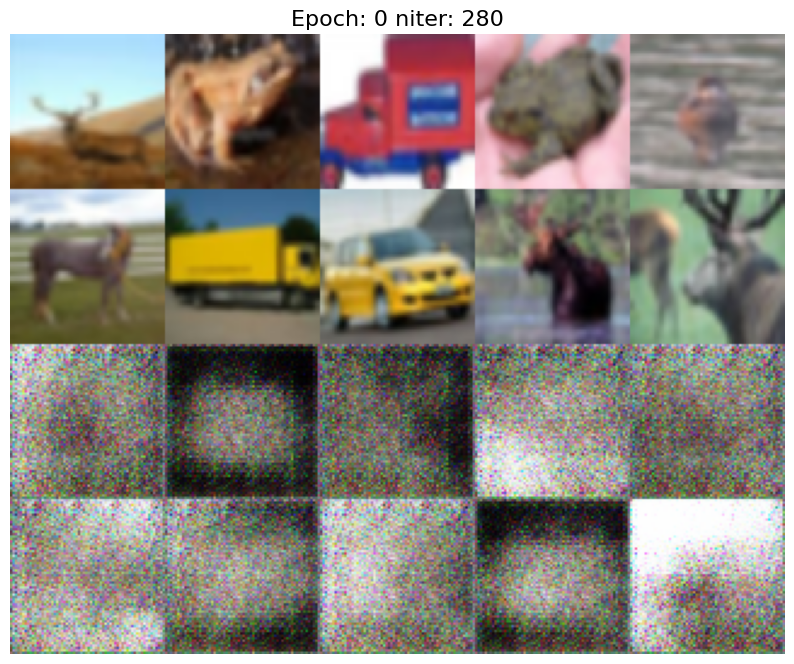

[1/25][280/500] Loss_D: 0.0001 Loss_G: -0.0010


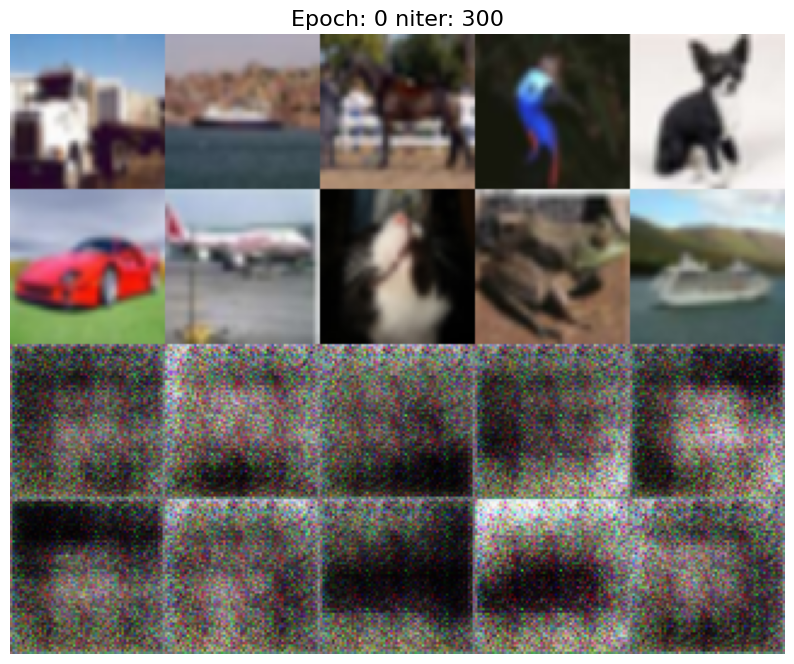

[1/25][300/500] Loss_D: -0.0000 Loss_G: -0.0006


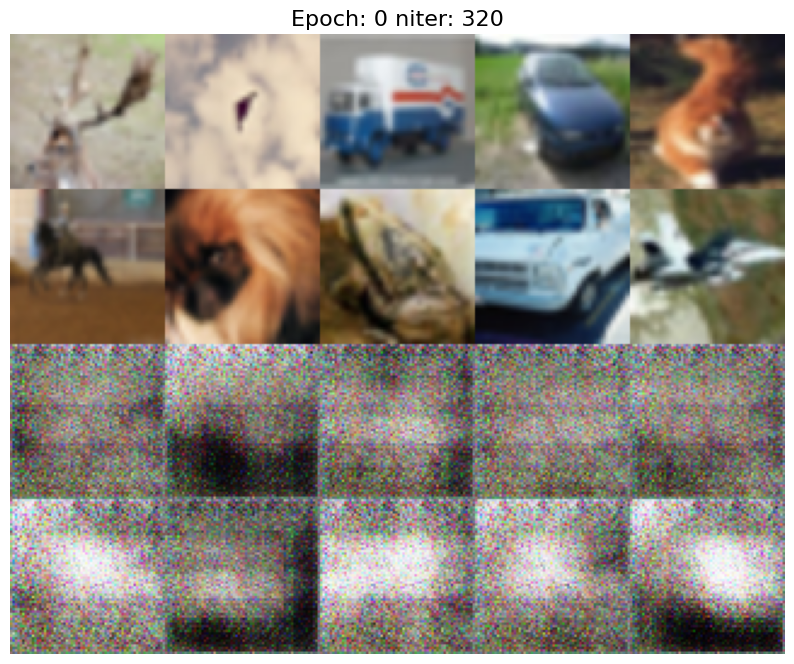

[1/25][320/500] Loss_D: 0.0000 Loss_G: -0.0004


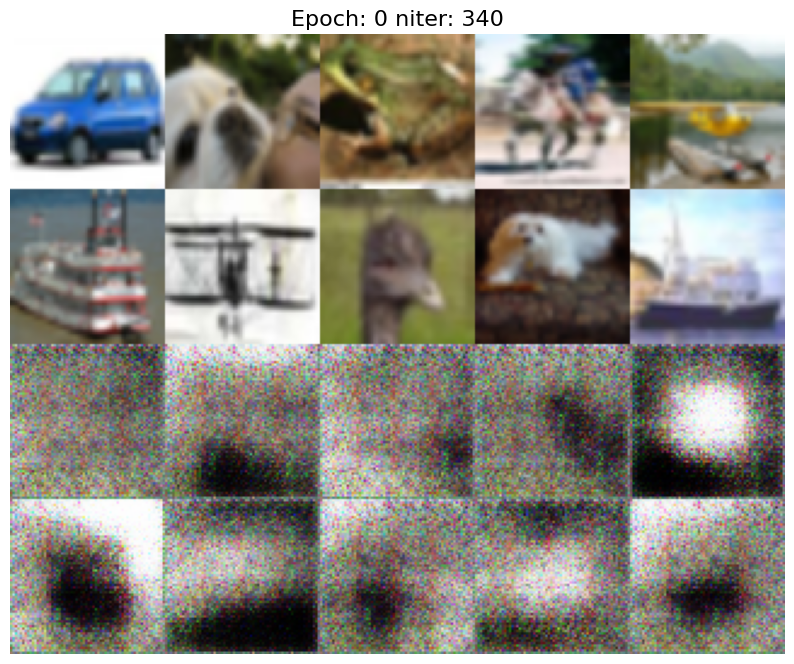

[1/25][340/500] Loss_D: 0.0000 Loss_G: -0.0004


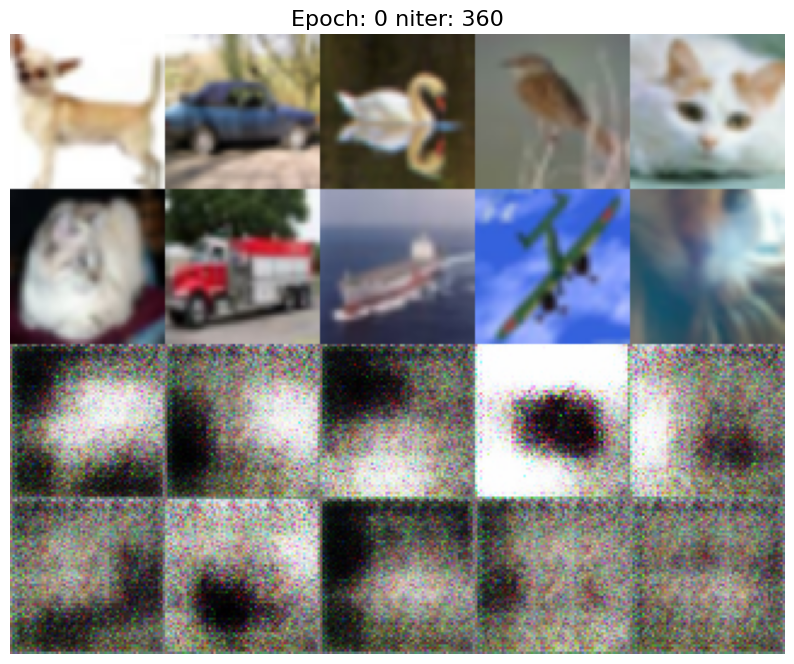

[1/25][360/500] Loss_D: -0.0000 Loss_G: -0.0005


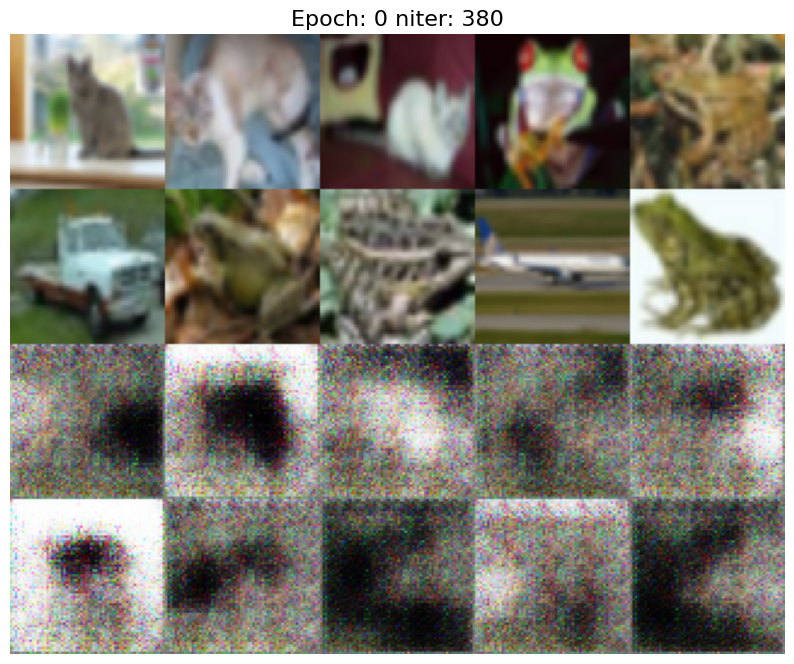

[1/25][380/500] Loss_D: 0.0000 Loss_G: -0.0004


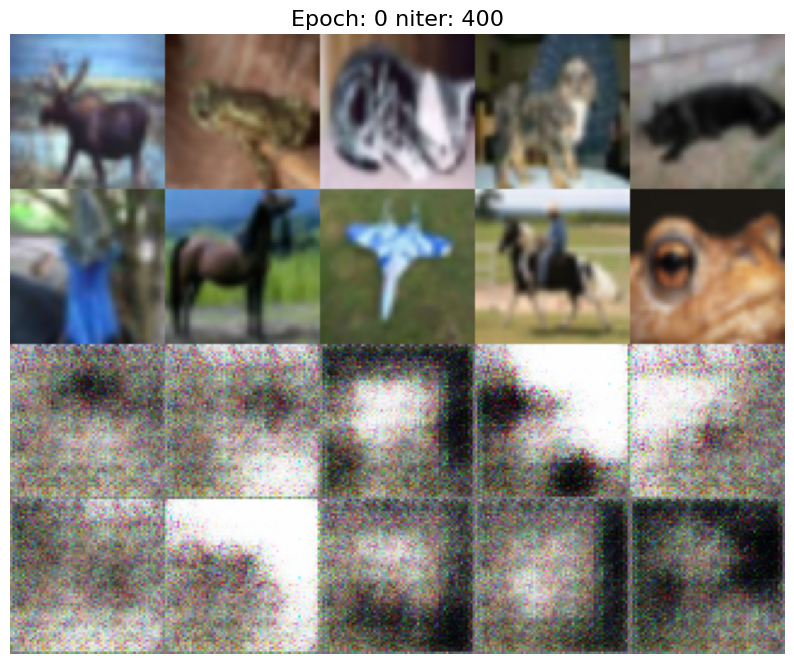

[1/25][400/500] Loss_D: -0.0000 Loss_G: -0.0007


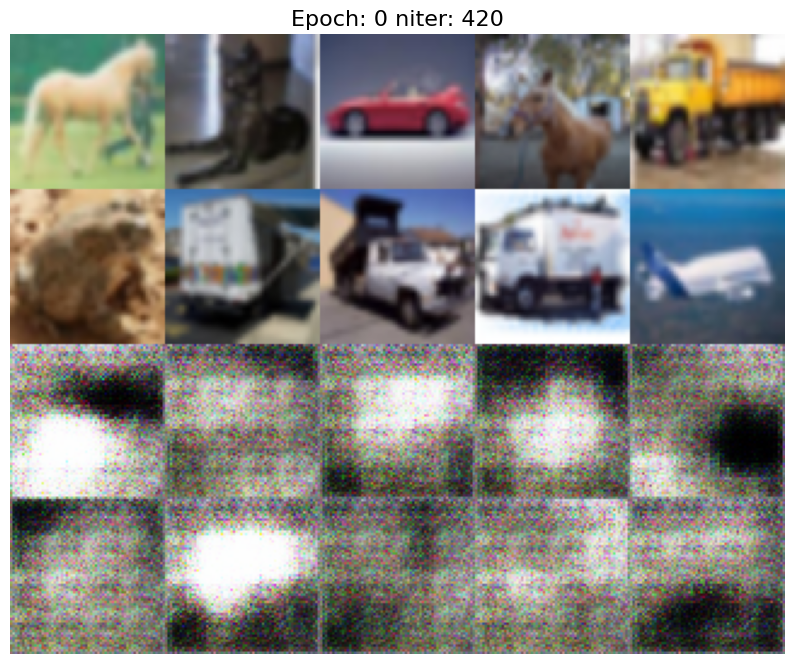

[1/25][420/500] Loss_D: -0.0004 Loss_G: -0.0009


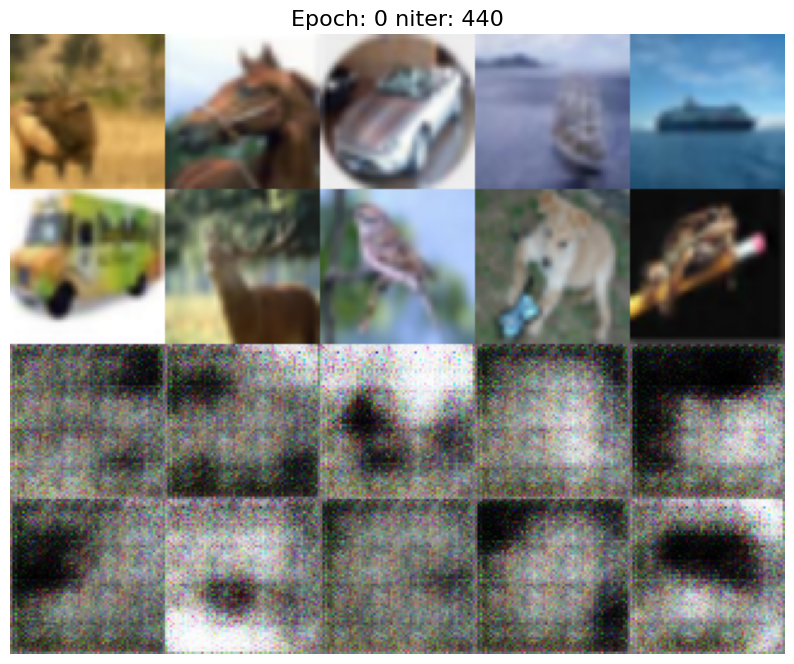

[1/25][440/500] Loss_D: -0.0001 Loss_G: -0.0007


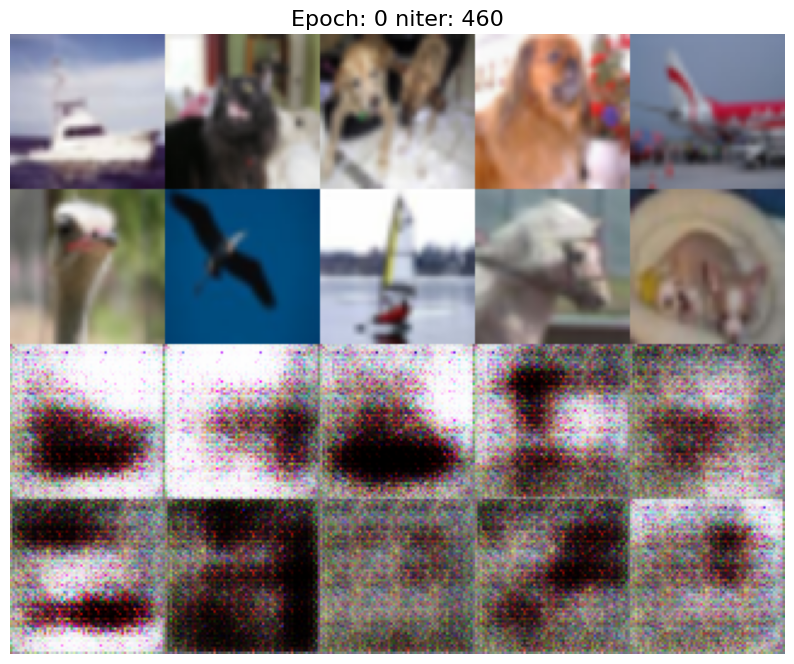

[1/25][460/500] Loss_D: -0.0006 Loss_G: -0.0011


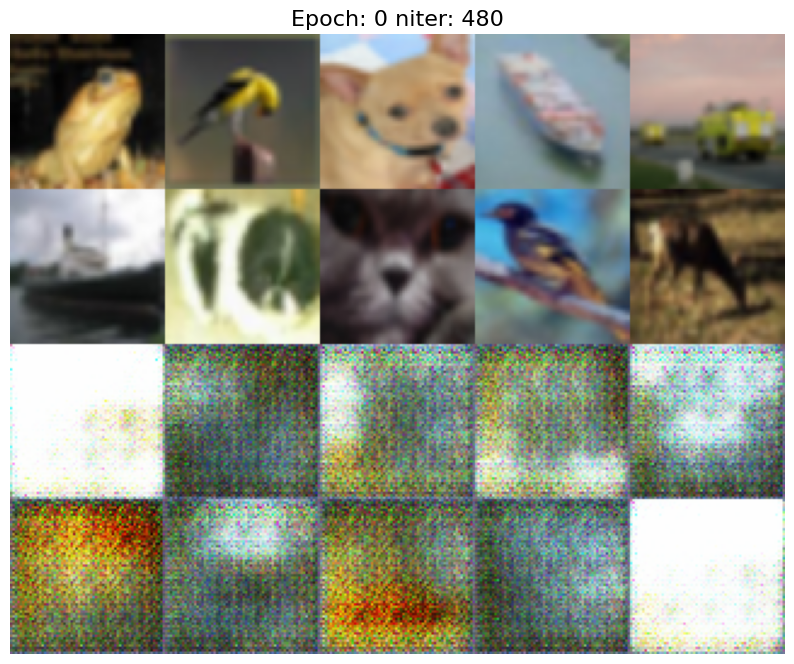

[1/25][480/500] Loss_D: -0.0003 Loss_G: -0.0039


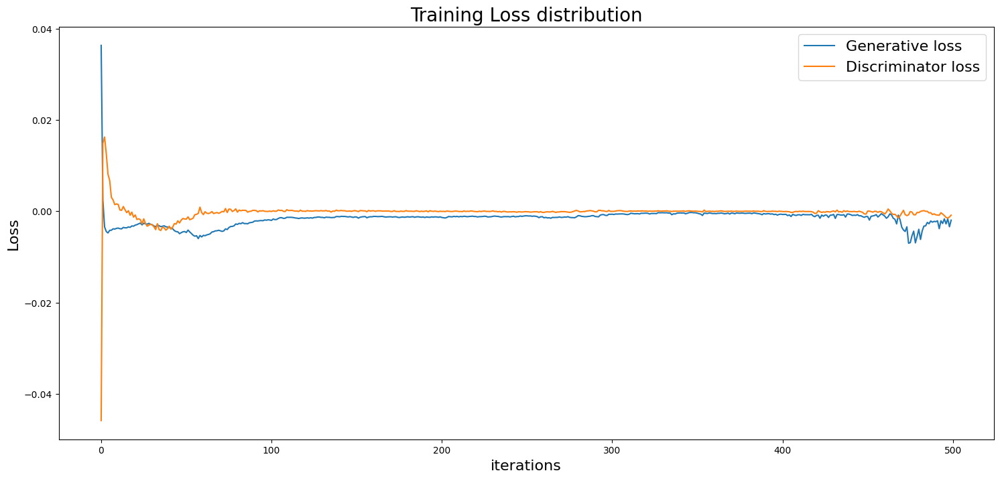

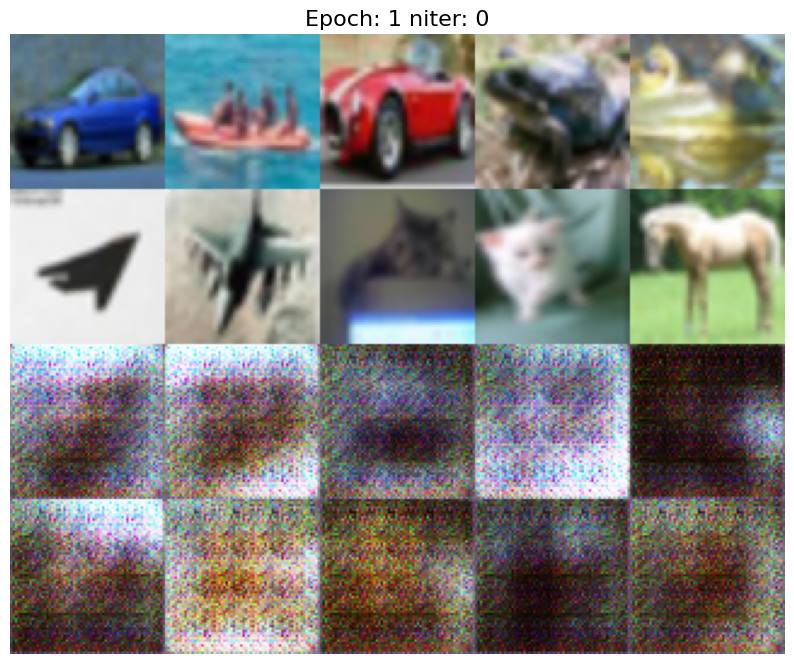

[2/25][0/500] Loss_D: -0.0013 Loss_G: -0.0018


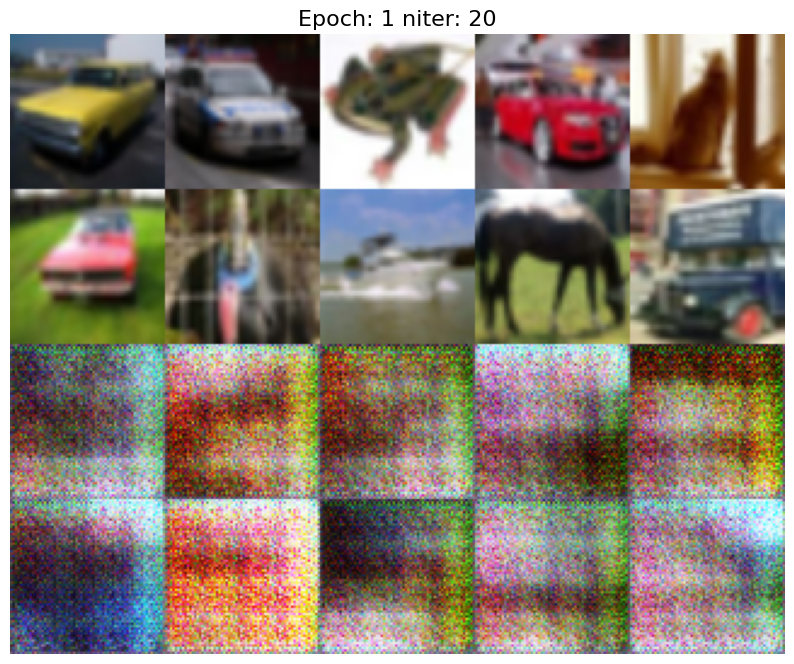

[2/25][20/500] Loss_D: -0.0010 Loss_G: -0.0003


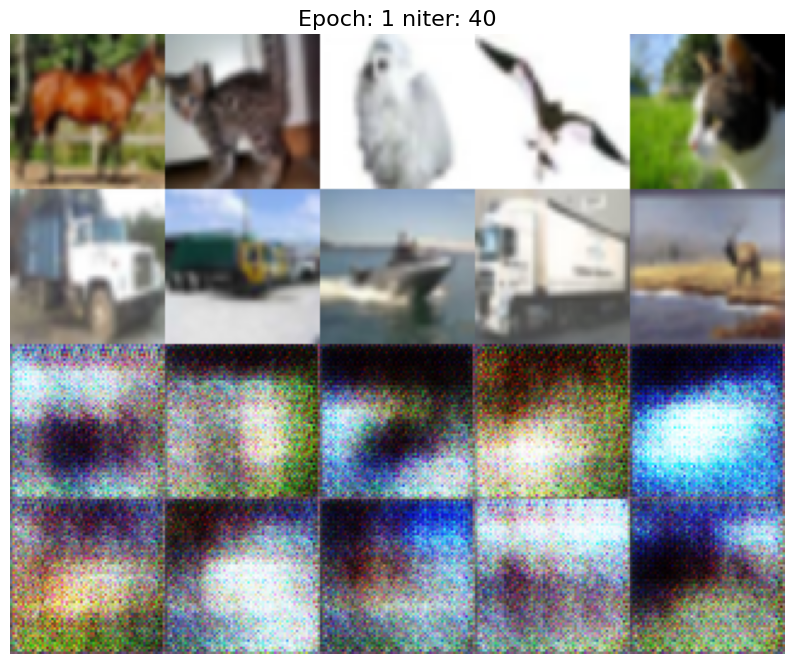

[2/25][40/500] Loss_D: -0.0011 Loss_G: -0.0017


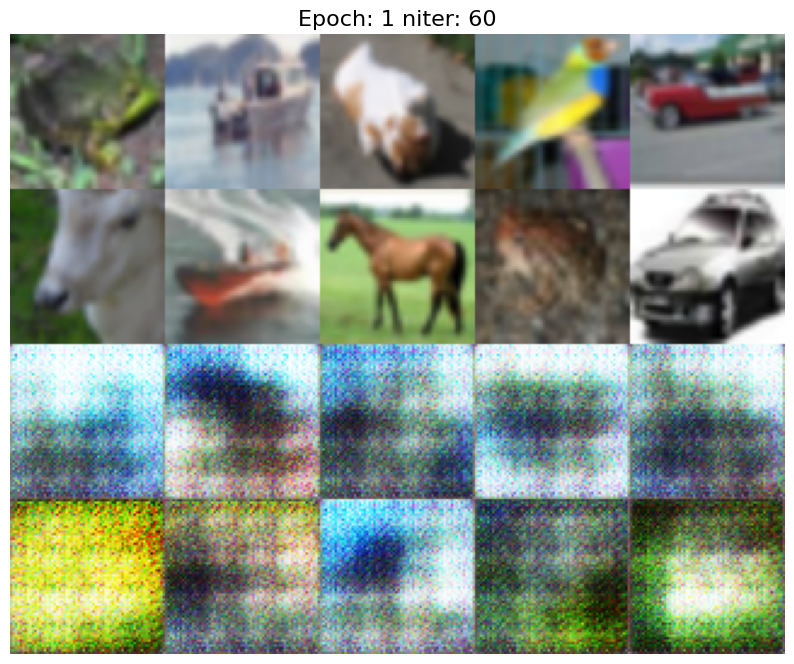

[2/25][60/500] Loss_D: -0.0009 Loss_G: -0.0017


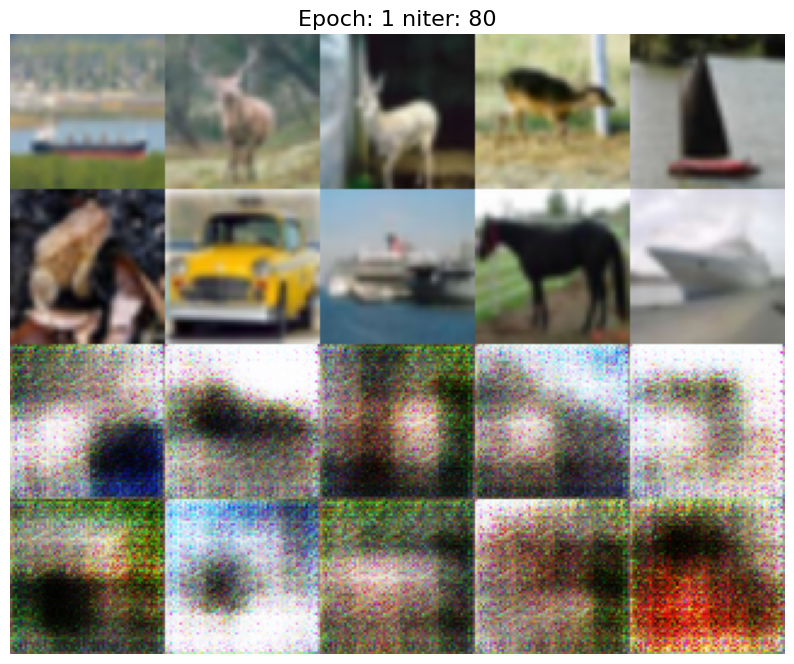

[2/25][80/500] Loss_D: -0.0014 Loss_G: -0.0007


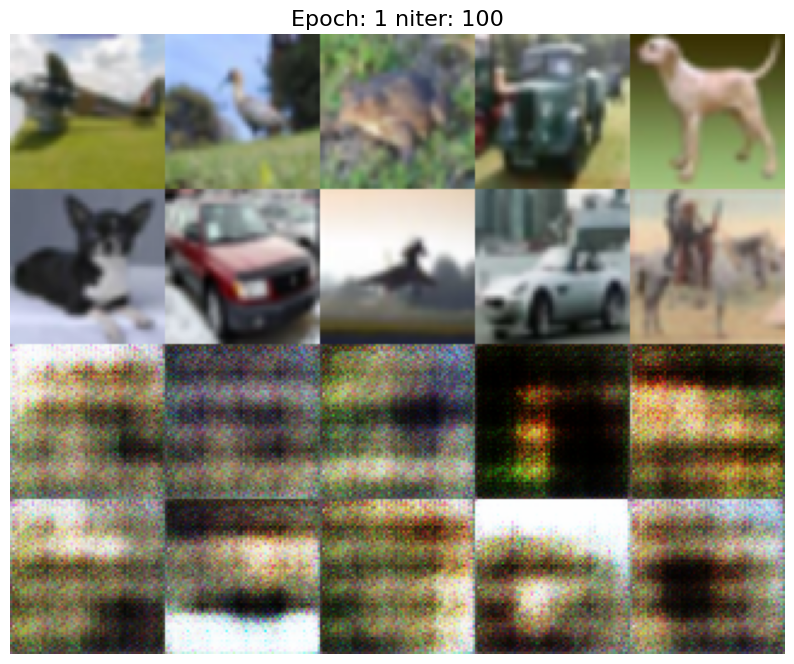

[2/25][100/500] Loss_D: -0.0009 Loss_G: -0.0067


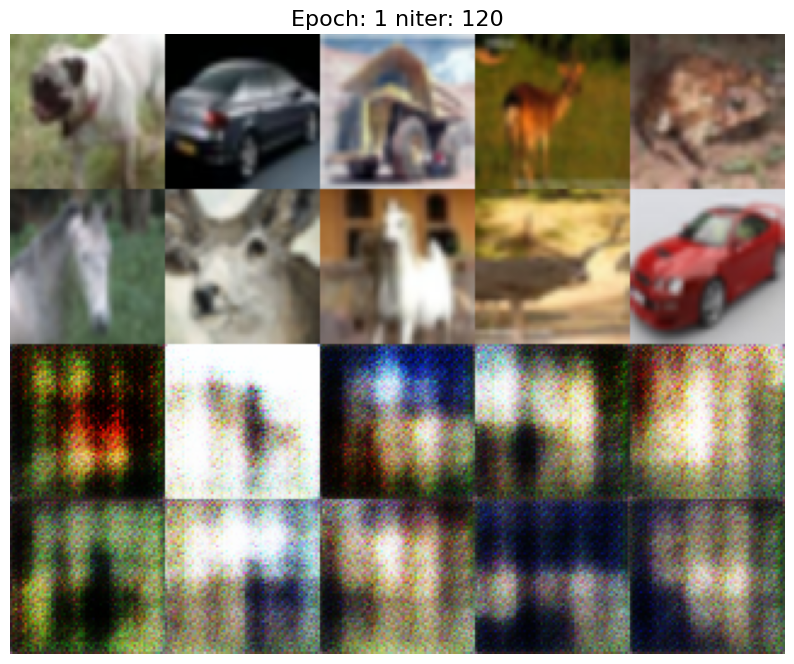

[2/25][120/500] Loss_D: -0.0054 Loss_G: 0.0003


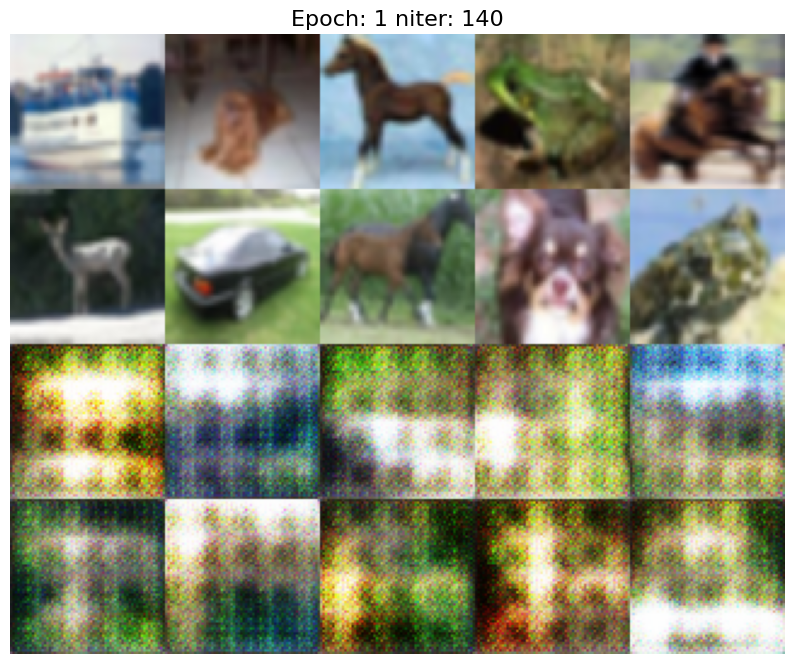

[2/25][140/500] Loss_D: -0.0108 Loss_G: 0.0077


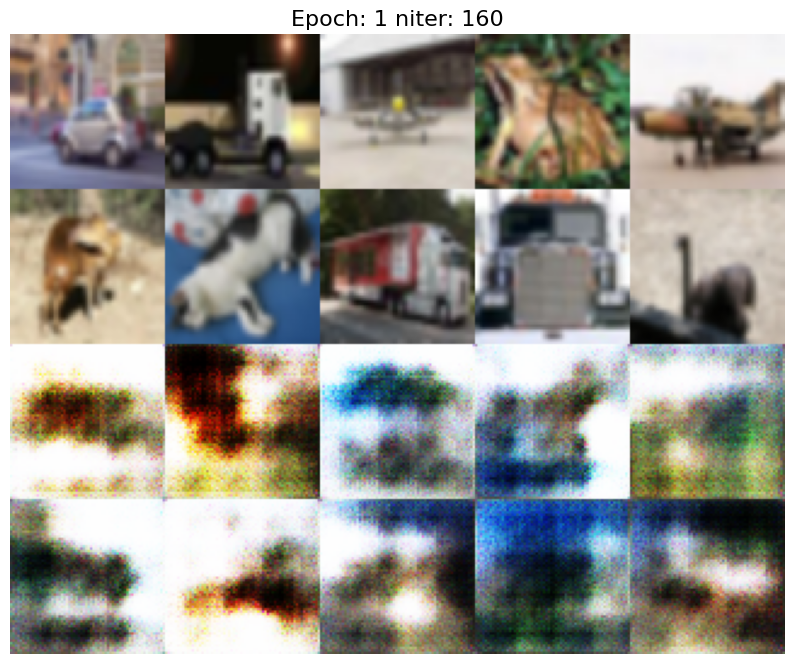

[2/25][160/500] Loss_D: -0.0021 Loss_G: 0.0328


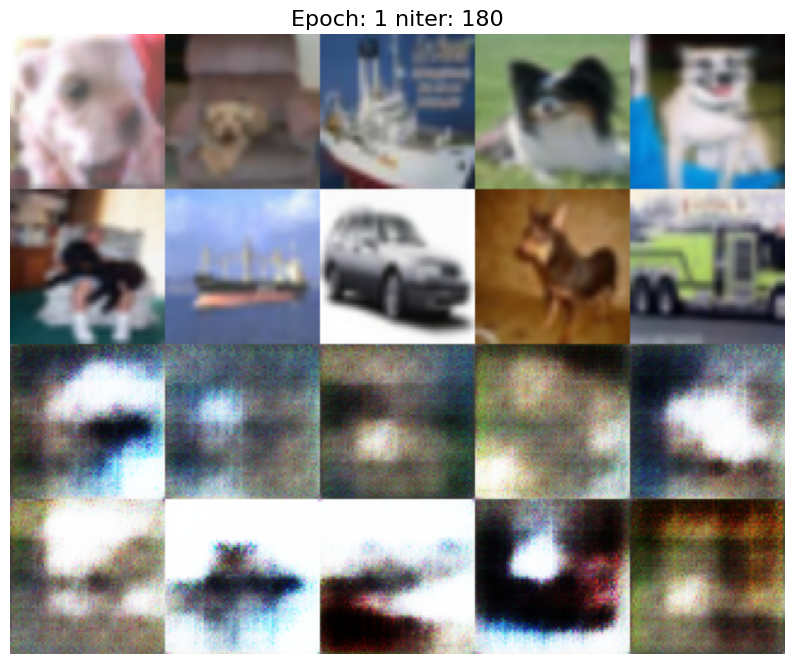

[2/25][180/500] Loss_D: -0.0691 Loss_G: 0.0854


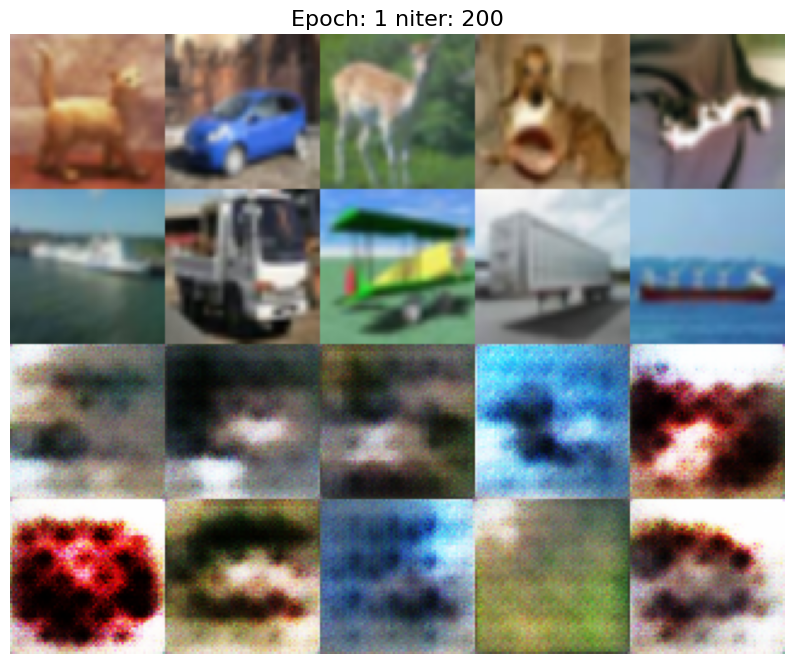

[2/25][200/500] Loss_D: -0.1811 Loss_G: 0.2100


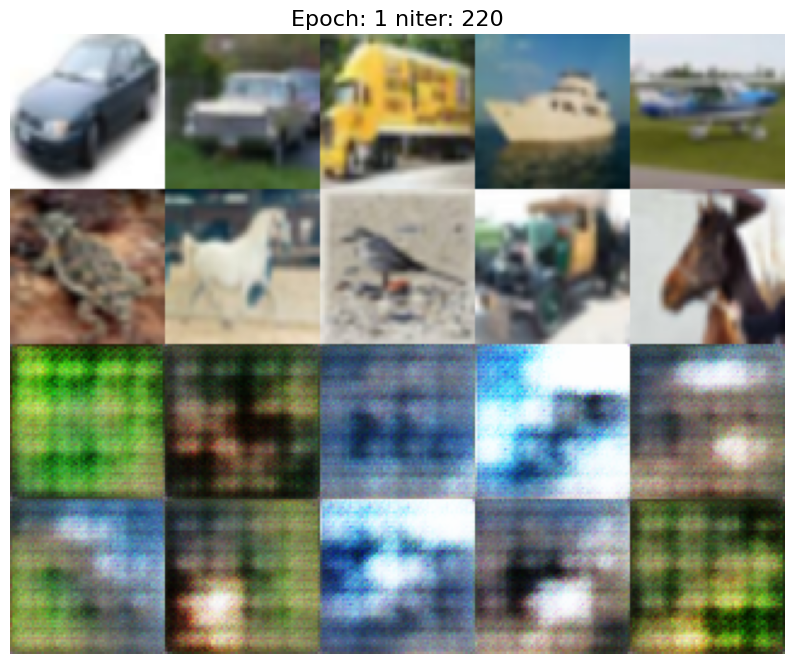

[2/25][220/500] Loss_D: -0.3102 Loss_G: 0.3740


In [ ]:
'''
Training
'''
D_period = 1
G_period = 1
G_loss_list = []
D_loss_list  = []
image_list = []
frame_list = []

print('start training...')
print('Epochs: %d | Batch Size: %d | Learning Rate: %.4f' % (EPOCH,BATCH,LR))
G.train(True)
D.train(True)
time_start = time.time()

for epoch in range(EPOCH):
    for i, data in enumerate(dataloader):
        
        '''
        Train D
        '''
        for k in range(D_period):
            optimizer_D.zero_grad()
            noise = torch.randn(BATCH, NOISE, 1, 1, device=device)
    
            real_data = data[0].to(device)
            fake_data = G(noise)
            
            loss_real = D(real_data)
            loss_fake = D(fake_data)
            
            #Wasserstein

            D_loss = -torch.mean(loss_real-loss_fake)
            
            D_loss.backward()
            optimizer_D.step()
            # D_x = output.mean().item()
            
            for p in D.parameters():
                p.data.clamp_(-0.01,0.01)
    
    
        '''
        Train G
        '''
        for m in range(G_period):
            optimizer_G.zero_grad()
            
            noise = torch.randn(BATCH, NOISE, 1, 1, device=device)
            fake_data = G(noise)
            
            loss_fake = D(fake_data)
            #Wasserstein
            G_loss = -torch.mean(loss_fake)
            
            G_loss.backward()
            optimizer_G.step()
            
            
            
        G_loss_list.append(G_loss.item())
        D_loss_list.append(D_loss.item())

            
        if i % (len(dataloader)//25) == 0:
            D.eval()
            G.eval()
            
            noise = torch.randn(10, NOISE, 1, 1, device=device)
            fake_data = G(noise)
            
            fake_images, G_image = Image_wall(fake_data)
            real_images,_ = Image_wall(real_data)
            frames = np.vstack((real_images,fake_images))
            
            plt.figure(figsize=(10,10))
            plt.imshow(frames)
            plt.axis('off')
            plt.title('Epoch: %d niter: %d'%(epoch,i),fontsize=16)
            plt.show()
            
            frame_list.append(G_image)
            image_list.append(fake_images)
            
            time_end = time.time()
            time_cost = time_end - time_start
            time_start = time.time()
            
            print('[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f' % (
                epoch+1, EPOCH, i, len(dataloader), D_loss.item(), G_loss.item()))

            D.train()
            G.train()


    #save for every epoch
    plt.figure(figsize=(18,8))
    plt.plot(G_loss_list, label='Generative loss')
    plt.plot(D_loss_list, label='Discriminator loss')
    plt.xlabel('iterations',fontsize=16)
    plt.ylabel('Loss',fontsize=16)
    plt.title('Training Loss distribution',fontsize=20)
    plt.legend(fontsize=16)
    plt.savefig('WGAN_loss.png')
    plt.show()
    torch.save(G.state_dict(), './weights/WGAN_G_test.pth')
    torch.save(D.state_dict(), './weights/WGAN_D_test.pth')




#save model
time_end_all = time.time()
print('Done! Totoal time cost: ',time_end_all-time_start_all)
t = time.strftime("%Y%m%d_%H%M", time.localtime()) 
torch.save(G.state_dict(), './weights/WGAN_G_'+t+'.pth')
torch.save(D.state_dict(), './weights/WGAN_D_'+t+'.pth')


def show_images(frame_list):
    n = len(frame_list)

    new_frame_list = []
    interval = n//EPOCH
    for i in range(0,n,interval): #print(i)
        index = random.randint(i, i+interval-1)
        new_frame_list.append(frame_list[index])
        
    n = len(new_frame_list) 
    col = 10
    row = n//col
    
    frames = np.array([])
    for i in range(row):
        frame_row = np.array([])
        for j in range(col):
            frame_i = new_frame_list[i*col + j]
            if j==0: frame_row = frame_i
            else: frame_row = np.hstack((frame_row,frame_i))
        
        if i==0: frames = frame_row
        else: frames = np.vstack((frames,frame_row))
    
    return frames
   
frames = show_images(frame_list)     

plt.figure(figsize=(10,10))
plt.imshow(frames)
plt.axis('off')
plt.title('WGAN Best after 25 Epochs')
plt.legend(fontsize=20)
plt.savefig('WGAN_image_wall_plot.png')
plt.show() 
cv2.imwrite('WGAN_image_wall.png', cv2.cvtColor(frames, cv2.COLOR_BGR2RGB))